# 1. Imports dependencies

In [5]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import zscore
import plotly.express as px



# 2. Load Data

In [6]:
df = pd.read_csv('../data/raw/sierraleone-bumbuna.csv')

# 3. Initial Inspection

In [6]:
print("Shape:", df.shape)
print("\nInfo:\n")
print(df.info())
print("\nMissing Values:\n", df.isna().sum())


Shape: (525600, 19)

Info:

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 525600 entries, 0 to 525599
Data columns (total 19 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   Timestamp      525600 non-null  object 
 1   GHI            525600 non-null  float64
 2   DNI            525600 non-null  float64
 3   DHI            525600 non-null  float64
 4   ModA           525600 non-null  float64
 5   ModB           525600 non-null  float64
 6   Tamb           525600 non-null  float64
 7   RH             525600 non-null  float64
 8   WS             525600 non-null  float64
 9   WSgust         525600 non-null  float64
 10  WSstdev        525600 non-null  float64
 11  WD             525600 non-null  float64
 12  WDstdev        525600 non-null  float64
 13  BP             525600 non-null  int64  
 14  Cleaning       525600 non-null  int64  
 15  Precipitation  525600 non-null  float64
 16  TModA          525600 non-null  float64
 17  T

# 4. Summary Statistics

In [7]:
summary_stats = df.describe()
summary_stats.T

,count,mean,std,min,25%,50%,75%,max
GHI,525600.0,201.957515,298.495150,-19.5,-2.8,0.3,362.4,1499.0
DNI,525600.0,116.376337,218.652659,-7.8,-0.3,-0.1,107.0,946.0
DHI,525600.0,113.720571,158.946032,-17.9,-3.8,-0.1,224.7,892.0
ModA,525600.0,206.643095,300.896893,0.0,0.0,3.6,359.5,1507.0
ModB,525600.0,198.114691,288.889073,0.0,0.0,3.4,345.4,1473.0
Tamb,525600.0,26.319394,4.398605,12.3,23.1,25.3,29.4,39.9
RH,525600.0,79.448857,20.520775,9.9,68.7,85.4,96.7,100.0
WS,525600.0,1.146113,1.239248,0.0,0.0,0.8,2.0,19.2
WSgust,525600.0,1.691606,1.617053,0.0,0.0,1.6,2.6,23.9
WSstdev,525600.0,0.363823,0.295000,0.0,0.0,0.4,0.6,4.1


# 5. Missing Value Report

In [8]:
missing_report = df.isnull().sum()
missing_percent = (missing_report / len(df)) * 100
missing = pd.DataFrame({'Missing Values': missing_report, 'Percent': missing_percent})
missing = missing[missing['Missing Values'] > 0].sort_values(by='Percent', ascending=False)
print("🔎 Columns with missing values > 5%:\n", missing[missing['Percent'] > 5])

🔎 Columns with missing values > 5%:
           Missing Values  Percent
Comments          525600    100.0


In [9]:
# Check for missing values
print("----------------------------------")
print("Check for missing values:")
print(df.isna().sum())

----------------------------------
Check for missing values:
Timestamp             0
GHI                   0
DNI                   0
DHI                   0
ModA                  0
ModB                  0
Tamb                  0
RH                    0
WS                    0
WSgust                0
WSstdev               0
WD                    0
WDstdev               0
BP                    0
Cleaning              0
Precipitation         0
TModA                 0
TModB                 0
Comments         525600
dtype: int64


In [10]:
# Drop the column of empity values:
df.drop(columns=['Comments'], inplace=True)

# 6. Outlier Detection with Z-Score

In [11]:
columns = ['GHI', 'DNI', 'DHI', 'ModA', 'ModB', 'WS', 'WSgust']
z_scores = df[columns].apply(zscore)
outliers = (z_scores.abs() > 3)
print("\n📛 Outliers per column:\n", outliers.sum())



📛 Outliers per column:
 GHI       2477
DNI       7586
DHI       2986
ModA      1604
ModB      2041
WS        3967
WSgust    3665
dtype: int64


# 7. Impute Outliers with Median

In [12]:
df_no_outliers = df[columns].mask(z_scores.abs() > 3)
df_imputed = df_no_outliers.fillna(df[columns].median())
df[columns] = df_imputed
df['was_outlier'] = outliers.any(axis=1)

# 8. Export Cleaned Data

In [15]:
df.to_csv("../data/sierraleone_clean.csv", index=False)

# 9. Time Series Plots


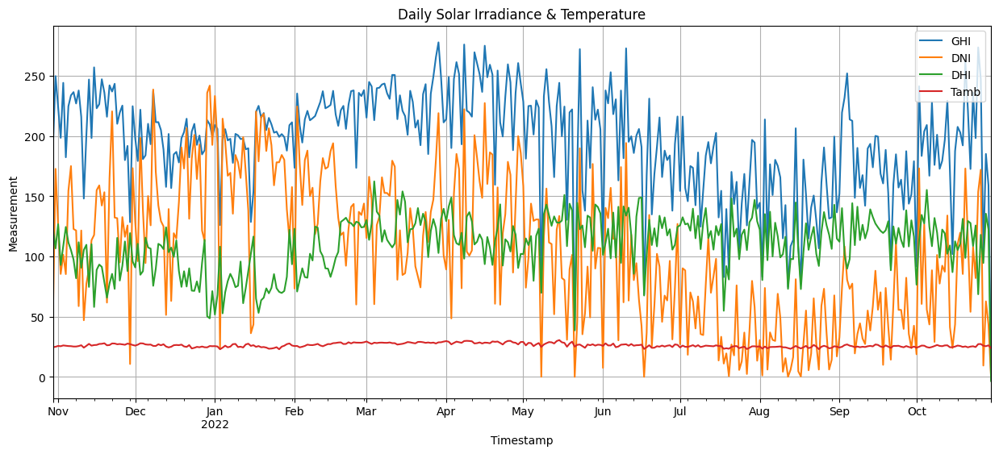

In [17]:
df['Timestamp'] = pd.to_datetime(df['Timestamp'])
df.set_index('Timestamp')[time_cols].resample("D").mean().plot(figsize=(15, 6), title="Daily Solar Irradiance & Temperature")
plt.ylabel("Measurement")
plt.grid(True)
plt.show()

# 10. Cleaning Impact

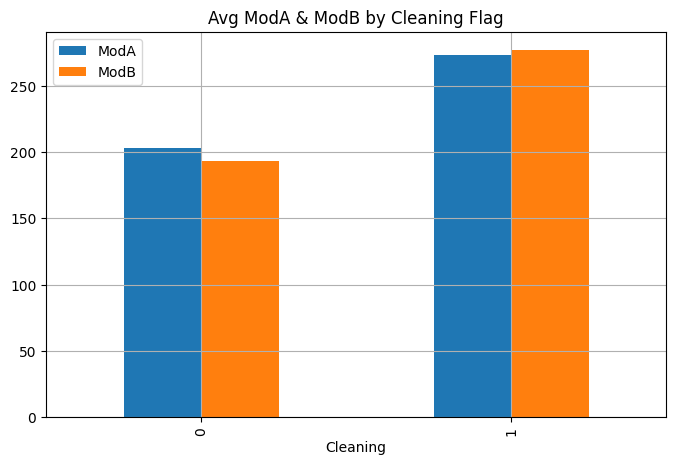

In [18]:
df['Cleaning'] = df['Cleaning'].fillna('Unknown')
df.groupby('Cleaning')[['ModA', 'ModB']].mean().plot(kind='bar', figsize=(8, 5), title='Avg ModA & ModB by Cleaning Flag')
plt.grid(True)
plt.show()

# 11. Correlation Heatmap

c:\Users\hp\Desktop\KAIM-solar-challenge-week0\venv\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 128279 (\N{LINK SYMBOL}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


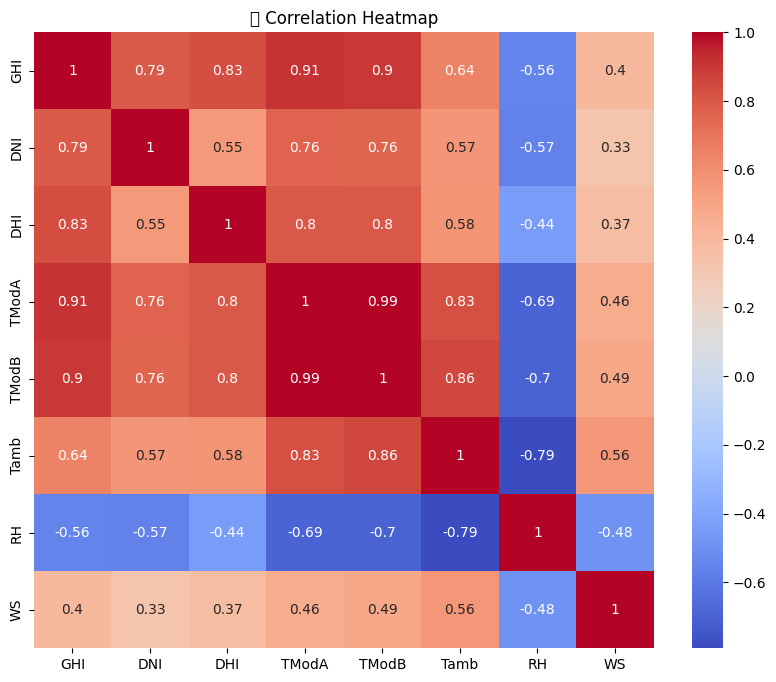

In [19]:
plt.figure(figsize=(10, 8))
sns.heatmap(df[['GHI', 'DNI', 'DHI', 'TModA', 'TModB', 'Tamb', 'RH', 'WS']].corr(), annot=True, cmap='coolwarm')
plt.title("🔗 Correlation Heatmap")
plt.show()

# 12. Scatter Plots - Relationships

c:\Users\hp\Desktop\KAIM-solar-challenge-week0\venv\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 128300 (\N{MICROSCOPE}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


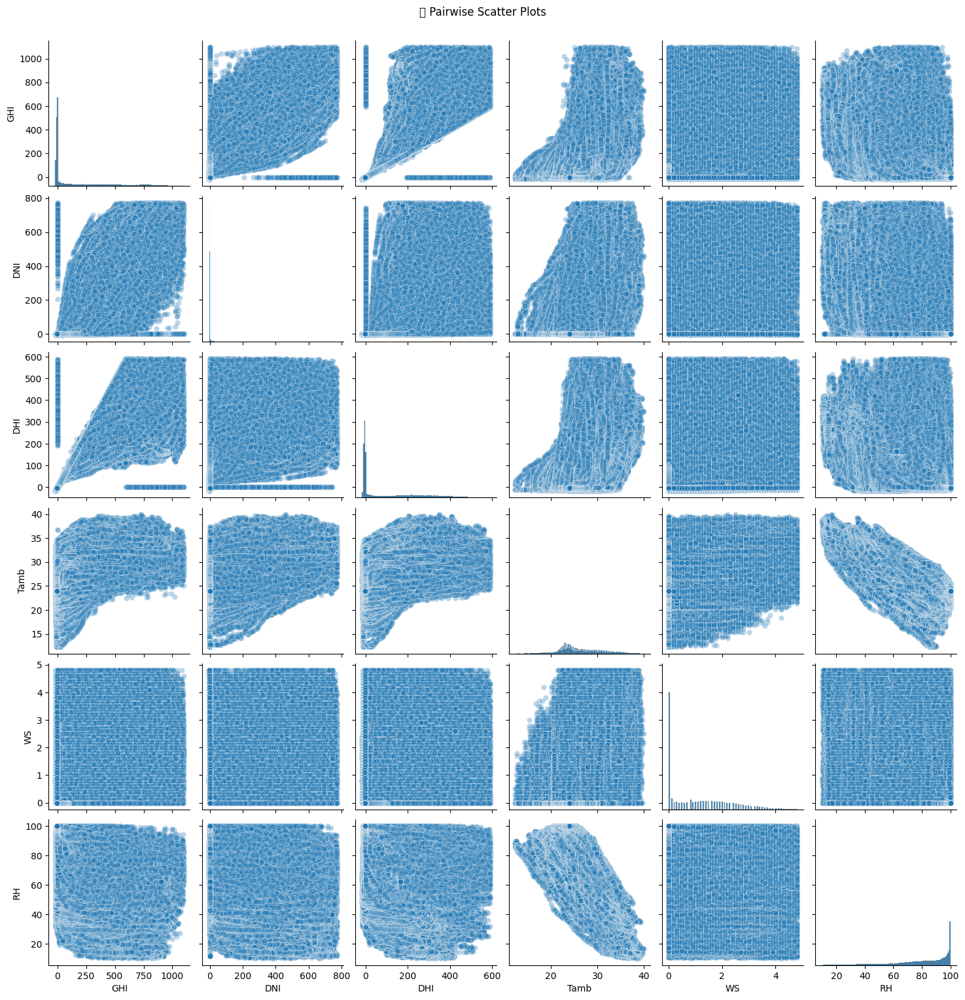

In [20]:
sns.pairplot(df, vars=['GHI', 'DNI', 'DHI', 'Tamb', 'WS', 'RH'], kind='scatter', plot_kws={'alpha': 0.3})
plt.suptitle("🔬 Pairwise Scatter Plots", y=1.02)
plt.show()

# 13. Wind Rose (Polar Bar)

In [7]:
wind_data = df[['WS', 'WD']].dropna()
wind_data['WD_bin'] = pd.cut(wind_data['WD'], bins=np.arange(0, 361, 30), labels=np.arange(0, 360, 30))
wind_avg = wind_data.groupby('WD_bin')['WS'].mean().reset_index()
fig = px.bar_polar(wind_avg, r='WS', theta='WD_bin', title='🌬️ Wind Speed Distribution by Direction', template='plotly_dark')
fig.show()

C:\Users\hp\AppData\Local\Temp\ipykernel_18692\2829234928.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  wind_avg = wind_data.groupby('WD_bin')['WS'].mean().reset_index()


# 14. Histograms

c:\Users\hp\Desktop\KAIM-solar-challenge-week0\venv\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning:

Glyph 128202 (\N{BAR CHART}) missing from font(s) DejaVu Sans.



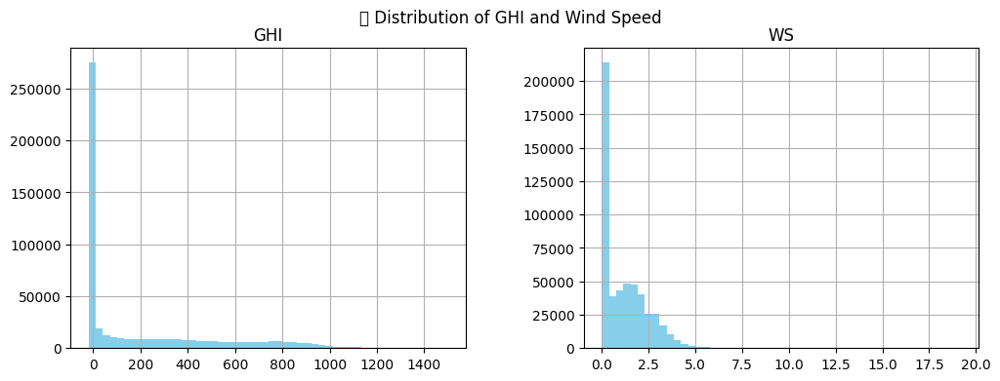

In [8]:
df[['GHI', 'WS']].hist(bins=50, figsize=(12, 4), color='skyblue')
plt.suptitle("📊 Distribution of GHI and Wind Speed")
plt.show()

# 15. Humidity vs Temperature vs Solar

In [9]:
fig = px.scatter(df, x='Tamb', y='GHI', size='RH', color='RH', title='GHI vs Tamb vs RH (Bubble = RH)', template='plotly_white')
fig.show()